# Biomass reference map generation for the Canal Zone, Panama

This workflow is a demonstration of one possible approach for creating aboveground biomass reference maps in R using airborne laser scanning (ALS) and field plot inventory data collected over plots located across the Canal Zone in central Panama.

### Extending field inventories with airborne lidar
Using local relationships between forest inventory data and ALS, this workflow (i) demonstrates ALS processing and registration to field data, (ii) compares independent results from different users of the same data, and (iii) produces biomass reference maps for large areas of forest. Users of this workflow will:

1. Prepare the workspace.
2. Access the ALS data and read it into a workspace as a LAScatalog.
3. Process the ALS data to produce terrain and canopy products.
4. Access the field plot data and associated geospatial data.
5. Generate figures illustrating the datasets.
6. Generate figures comparing results from different users.
7. Quantify aboveground biomass from field data.
8. Build a model of aboveground biomass from ALS metrics.
9. Validate the model.
10. Generate a biomass reference map for the entire ALS acquisition area.

<!-- Forest metrics such as canopy height and canopy cover can be extracted from discrete return lidar and related to aboveground biomass measurements from the field. This relationship produces a locally-calibrated model for predicting aboveground biomass from airborne lidar, and this model is applied to lidar data outside of the field plot to garner predictions of gridded aboveground biomass density.

The process will be following Armston et al. 2020. AfriSAR: Gridded Forest Biomass and Canopy Metrics Derived from LVIS, Gabon, 2016. ORNL DAAC, Oak Ridge, Tennessee, USA. https://doi.org/10.3334/ORNLDAAC/1775 -->


***

### **1.** Prepare the workspace.

- This notebook is designed to run on the NASA MAAP in a "MAAP R Stable" workspace. 
- To prepare the workspace, install packages via the terminal and restart the kernel in this notebook:
    - Install from configuration file (this is much faster):
 
      `conda env create -f ./environments/biomass_panama.yml --force`
 
    - Code for saving the current environment as a .yml for later:
 
      `conda env export > ./environments/biomass_panama.yml`


      - When necessary, install packages individually with conda install:

        `conda install r-rcsf r-rstoolbox r-ggpubr`

- Load the necessary packages in R:

In [5]:
# this package couldn't be found by conda, so we have to install it temporarily

install.packages('BIOMASS')

Warning message in install.packages("BIOMASS"):
“'lib = "/opt/conda/envs/r/lib/R/library"' is not writable”


ERROR: Error in install.packages("BIOMASS"): unable to install packages


In [4]:
# load in the required R packages

#suppressMessages({

library(ggpubr)
library(sf)
library(future)
library(terra)
library(rstac)
library(aws.s3)
library(tidyverse)
library(lidR)
library(RCSF)
library(RStoolbox)
#library(BIOMASS)

#})

ERROR: Error in library(ggpubr): no library trees found in 'lib.loc'



***

### **2.** Access the ALS data and read it into the workspace as a LAScatalog.

In [3]:
# read the location of the raw point clouds
# as a LAScatalog

#als_path <- '/projects/shared-buckets/minord/data/panama_bci/ALS'
als_path <- './data/ALS/raw'

ctg <- readLAScatalog(als_path) |>
    suppressMessages()
    #catalog_intersect(bci_50ha_plot_buf)

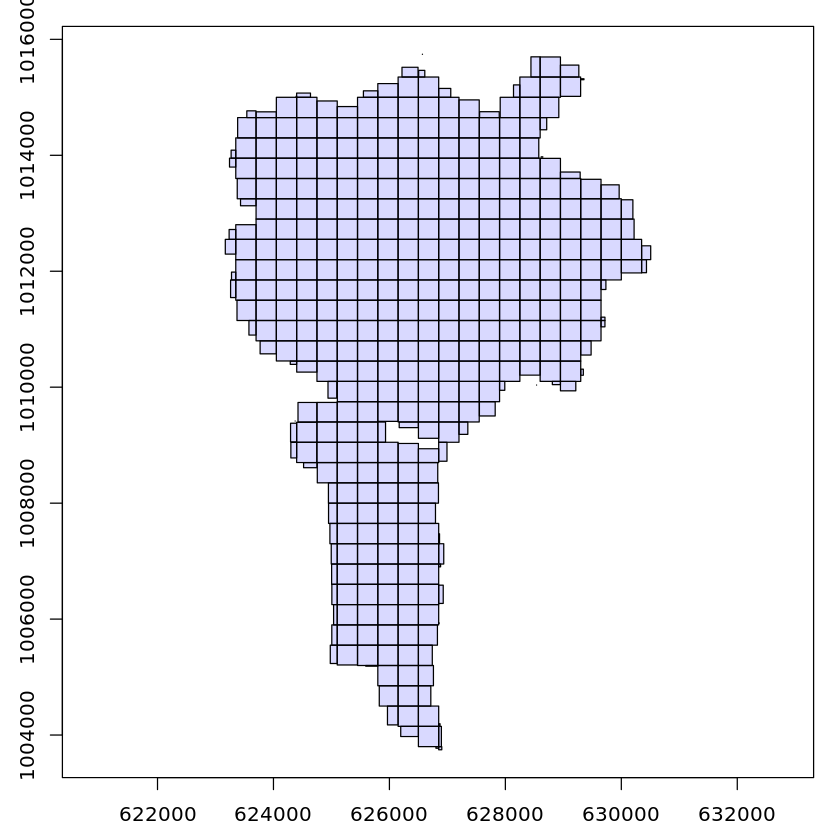

In [4]:
# retile the ALS data to its bucket

future::plan(multicore, workers = 24)

data_path = './data/ALS/inputs'

if (file.exists(data_path)) {

    CTG = readLAScatalog(data_path)
    
} else {

    dir.create(data_path, recursive = TRUE)
    
    opt_chunk_size(ctg) <- 350
    opt_chunk_buffer(ctg) <- 0
    opt_output_files(ctg) <- paste0(data_path, '/{XCENTER}_{YCENTER}')
    opt_filter(ctg) = "-drop_withheld -keep_return 1 2 3 4 5 -drop_number_of_returns 0"
    #-keep_xy 626900 1010550 627200.5 101750.5

    CTG = catalog_retile(ctg)
    
}

plot(CTG)


### **3.** Process the ALS data to produce terrain and canopy products.

### _1_filter_returns
Depending on the supplier of the ALS, the point clouds can contain very high return numbers, which are less likely to be meaningful, or erroneous points with return numbers greater than the number of returns or values of zero. Drop these points. 

In [5]:
# perform a voxel filtering to remove noise 

future::plan(multicore, workers = 24)

# define a function to filter returns on a lascatalog
filter_returns <- function(chunk, max = 5) # user defined function
{
  las <- readLAS(chunk)  
  if (is.empty(las)) return(NULL)  
  las_new <- filter_poi(las, 
                        ReturnNumber %in% seq(1, max, 1) &
                        NumberOfReturns %in% seq(1, max, 1) &
                        ReturnNumber <= NumberOfReturns) 
  return(las_new)
}


data_path = './data/ALS/outputs/_1_filter_returns'

if (file.exists(data_path)) {

    RETURNS <- readLAScatalog(data_path)
    
} else {
    
    dir.create(data_path, recursive = TRUE)

    options <- list(automerge = TRUE) # merge all the outputs
    opt_chunk_buffer(CTG) <- 0
    opt_output_files(CTG) <- paste0(data_path, '/{XCENTER}_{YCENTER}')
    opt_filter(CTG) = "-drop_withheld -filter_with_voxel .01"
    
    RETURNS <- catalog_apply(CTG, filter_returns, max = 5)

    RETURNS <- readLAScatalog(data_path)
    
}

#plot(RETURNS)

### _2_filter_noise
Isolated points occuring above or below the canopy will affect canopy metrics downstream, and should be removed. These points can represent real returns from birds or aerosols or can be artifacts, especially near water features. 

In [6]:
# filter noise

future::plan(multicore, workers = 16)

#RETURNS = readLAScatalog('./data/ALS/outputs/test')

data_path = './data/ALS/outputs/_2_filter_noise'

if (file.exists(data_path)) {

    NOISE <- readLAScatalog(data_path)
    
} else {
    
    dir.create(data_path, recursive = TRUE)
    
    # opt_chunk_size(CTG) <- 500
    opt_chunk_buffer(RETURNS) <- 10
    opt_output_files(RETURNS)<- paste0(data_path, '/{XCENTER}_{YCENTER}')
    #opt_filter(NOISE) = "-drop_withheld -drop_class 18"

    #NOISE2 <- catalog_retile(PROBLEM)
    NOISE <- classify_noise(RETURNS, ivf(res = 6, n = 250))
    
}

In [29]:
# define some variables for plotting point cloud transects in ggplot

theme_transect <- theme(
    panel.border = element_rect(color = "black", fill = NA, size = 1),
    panel.grid.major.x = element_blank(),
    panel.grid.minor.x = element_blank(),
        #axis.text.x = element_text(angle = 90),
        axis.ticks = element_blank(),
        axis.title.x = element_text(margin = margin(16, 3, 3, 3)),
        axis.title.y = element_text(margin = margin(3, 16, 3, 3)),
        legend.position.inside = c(.987, .95),
        legend.justification = c(1, 1),
        panel.background = element_rect(fill = "white"),
        legend.key = element_rect(fill = "white", color = "white"),
        legend.title = element_blank(),
        legend.direction = "vertical",
        legend.key.width = unit(.3, "in"),
        legend.key.height = unit(.3, "in"),
        legend.background = element_rect(color = "black", fill = "white", linewidth = .5),
        legend.margin = margin(6, 6, 6, 6))

In [8]:
# plot transect noise filtering

test = readLAS('.//data/ALS/outputs/_2_filter_noise/624575_1013075.las')

p1 <- c(624487, 1012900) 
p2 <- c(624581 , 1013161.5)
las_tr <- clip_transect(test, p1, p2, width = 2, xz = TRUE)


fig = ggplot(payload(las_tr), aes(X,Z, color = factor(Classification))) + 
  geom_point(size = 2, alpha = .5, shape = 20) + 
    geom_point(data = filter(payload(las_tr), Classification == 18),
               size = 5, alpha = .5) + 
  coord_equal() + 
  theme_bw(base_size = 15) +
   scale_x_continuous(expand = expansion(mult = c(.05, .05)),
                     breaks = seq(0, 250, 50)) + 
   lims(y = c(20, 90)) +
    theme_transect +
    labs(x = "Transect distance (m)", y = "Elevation (m)") +
    scale_color_manual(labels = c("0" = "Unclassified",
                                 "18" = "Noise"),
                      values = c("darkseagreen", "blueviolet"))

ggsave(plot = fig, 
       filename = "./figures/point_clouds/cross_section_NOISE.jpeg", 
       device = jpeg,
       width = 14,
       height = 5,
       units = "in",
       dpi = 300,
       bg = "white")


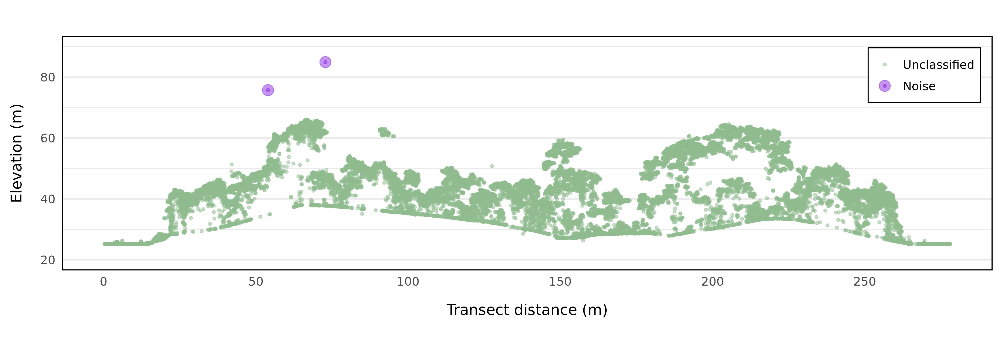


**A cross section of a point cloud illustrating points classified as noise with the isolated voxels filter.**

### _3_classify_ground
Point cloud Z values represent absolute elevation rather than canopy height. To quantify canopy height, it is necessary to subtract the elevation of terrain. To produce a terrain model, first classify ground returns using a cloth simulation filter algorithm. 

In [9]:
# classify ground points, discarding noise points

#future::plan(sequential)
future::plan(multicore, workers = 12)

#NOISE = readLAScatalog('./data/ALS/outputs/test')

data_path = './data/ALS/outputs/_3_classify_ground'


if (file.exists(data_path)) {

    GROUND <- readLAScatalog(data_path)
    
} else {
    
    dir.create(data_path, recursive = TRUE)
    
    # opt_chunk_size(CTG) <- 500
    opt_chunk_buffer(NOISE) <- 50
    opt_output_files(NOISE)<- paste0(data_path, '/{XCENTER}_{YCENTER}')
    # we will use only last returns, for the sake of ground classification
    opt_select(NOISE) <- "xyzc"
    opt_filter(NOISE) <- "-thin_with_voxel .05 -drop_class 18 -drop_withheld"
    
    GROUND <- classify_ground(NOISE, csf(sloop_smooth = TRUE,
                                         class_threshold = .25,
                                         cloth_resolution = .5,
                                         rigidness = 2L,
                                         iterations = 500L,
                                         time_step = 0.65),
                             last_returns = TRUE)
    }

#plot(GROUND)

# drop very small edge tiles
GROUND = GROUND[GROUND$Number.of.point.records > 10000]
#plot(GROUND)

In [10]:
# plot transect ground classification
test = readLAS('.//data/ALS/outputs/_3_classify_ground/624575_1013075.las')

p1 <- c(624487, 1012900) 
p2 <- c(624581 , 1013161.5)
las_tr <- clip_transect(test, p1, p2, width = 2, xz = TRUE)


fig = ggplot(payload(las_tr), aes(X,Z, color = factor(Classification))) + 
  geom_point(size = 2, alpha = .5, shape = 20) + 
  coord_equal() + 
  theme_bw(base_size = 15) +
   scale_x_continuous(expand = expansion(mult = c(.05, .05)),
                     breaks = seq(0, 250, 50)) + 
   lims(y = c(20, 90)) +
    theme_transect +
    labs(x = "Transect distance (m)", y = "Elevation (m)") +
    scale_color_manual(labels = c("0" = "Unclassified",
                                 "2" = "Ground"),
                      values = c("darkseagreen", "red4"))

ggsave(plot = fig, 
       filename = "./figures/point_clouds/cross_section_GROUND.jpeg", 
       device = jpeg,
       width = 14,
       height = 5,
       units = "in",
       dpi = 300,
       bg = "white")

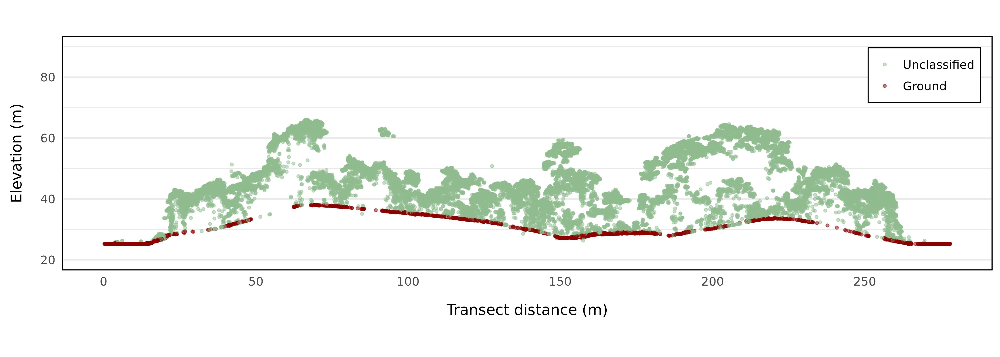


**A cross section of a point cloud illustrating points classified as ground with the cloth simulation filter.**

### _4_DTM
From classified ground retuns, produce a raster of terrain elevations by producing a triangualted irregular network (TIN) from the lowest value within each pixel. Also perform some smoothing to produce a realistic model for canopy hight normalization. 

In [11]:
# create a DTM

future::plan(multicore, workers = 12)

data_path = './data/ALS/outputs/_4_DTM'

if (file.exists(data_path)) {

    DTM <- terra::vrt(paste0(data_path, "/rasterize_terrain.vrt"))
    
} else {
    
    dir.create(data_path, recursive = TRUE)
    
    # opt_chunk_size(CTG) <- 500
    opt_chunk_buffer(GROUND) <- 25
    opt_output_files(GROUND)<- paste0(data_path, '/DTM_{XCENTER}_{YCENTER}')
    opt_filter(GROUND) <- "-drop_withheld -keep_class 2"

    # lidR's tin() uses only first returns, so I've coded my own way based on medians and interpolation...
    DTM <- suppressWarnings(grid_terrain(GROUND,
                                         res = 2,
                                         algorithm = tin(),
                                         keep_lowest = TRUE,
                                         use_class = c(2L),
                                         pkg = "terra"))
}



In [12]:
# smooth the DTM

DTM_smooth <- DTM %>%
    #terra::ifel(is.na(.), DTM, .) |>
        terra::focal(w=5, fun="median", na.policy="only", na.rm=TRUE)  |>
        terra::focal(w=3, fun="median", na.policy="all", na.rm=TRUE) |>
        focal(w = focalMat(DTM, 1, "Gauss"), na.policy="all", na.rm=FALSE)

### _5_normalize_heights
Subtract the terrain value from the Z values in the point cloud to produce a new point cloud where Z represents normalized canopy height. 

In [13]:
# normalize the point clouds

#future::plan(sequential)
future::plan(multicore, workers = 16)

data_path = './data/ALS/outputs/_5_normalize_height'

if (file.exists(data_path)) {

    NORM <- readLAScatalog(data_path)
    
    
} else {
    
    dir.create(data_path, recursive = TRUE)

    # drop tiles with almost no points
    NOISE = NOISE[NOISE$Number.of.point.records > 10000]
    
    # opt_chunk_size(CTG) <- 500
    opt_chunk_buffer(NOISE) <- 5
    opt_output_files(NOISE)<- paste0(data_path, '/{XCENTER}_{YCENTER}')
    opt_filter(NOISE) <- "-drop_class 18 -drop_withheld"
    
    NORM <- normalize_height(NOISE, 
                             use_class = c(0L),
                             algorithm = tin(),
                             add_lasattribute = FALSE, 
                             dtm = DTM_smooth)
    
}

# drop small edge tiles with very few points
#NORM = NORM[NORM$Number.of.point.records > 10000]

In [14]:
# plot transect canopy height
test = readLAS('.//data/ALS/outputs/_5_normalize_height/624575_1013075.las')

p1 <- c(624487, 1012900) 
p2 <- c(624581 , 1013161.5)
las_tr <- clip_transect(test, p1, p2, width = 2, xz = TRUE)


fig = ggplot(payload(las_tr), aes(X,Z, color = factor(Classification))) + 
  geom_point(size = 2, alpha = .5, shape = 20, color = "darkseagreen") + 
  coord_equal() + 
  theme_bw(base_size = 15) +
   scale_x_continuous(expand = expansion(mult = c(.05, .05)),
                     breaks = seq(0, 250, 50)) + 
   lims(y = c(-20, 50)) +
    theme_transect +
    labs(x = "Transect distance (m)", y = "Canopy height (m)") +
    guides(legend.position = "none")

ggsave(plot = fig, 
       filename = "./figures/point_clouds/cross_section_NORM.jpeg", 
       device = jpeg,
       width = 14,
       height = 5,
       units = "in",
       dpi = 300,
       bg = "white")

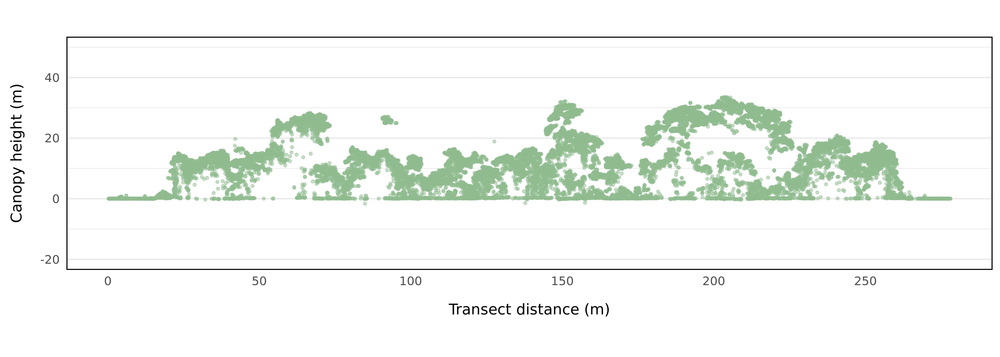


**A cross section of a point cloud illustrating points with Z values representing canopy height, after normalization to a digital terrain model.**

### _6_CHM
Produce a raster dataset representing canopy height from the maximum Z value within each pixel. Apply a roughness-median filter to fill in data gaps and clean up erroneous points. 

In [15]:
# make a CHM

#future::plan(multicore, workers = 16)

data_path = './data/ALS/outputs/_6_CHM'

if (file.exists(data_path)) {

    CHM <- terra::vrt(paste0(data_path, "/pixel_metrics.vrt"))
    #CHM <- terra::vrt(paste0(data_path, "/rasterize_canopy.vrt"))
    
} else {
    
    dir.create(data_path, recursive = TRUE)
    
    # opt_chunk_size(CTG) <- 500
    opt_chunk_buffer(NORM) <- 10
    opt_output_files(NORM)<- paste0(data_path, '/CHM_{XCENTER}_{YCENTER}')
    opt_filter(NORM) <- "-drop_below -.5"
    
    CHM <- pixel_metrics(NORM, ~max(Z), res = 1)
    
    # CHM <- rasterize_canopy(NORM,
    #                     res = 2,
    #                     algorithm = p2r(.5),
    #                     pkg = "terra")
}



In [16]:
# clean up the CHM
# filling irregularities in the CHM with roughness and median filters:
# first, identify areas of likely gaps, noise, or sparse data where 
# the terrain roughness index (TRI) is greater than 5. Then, apply a 
# median filter to those pixels only.

CHM_smooth <- CHM %>%
        terra::focal(w=3, fun="median", na.policy="only", na.rm=TRUE) %>%
        ifel(terra::terrain(., "TRI") > 5,
             terra::focal(., w = 3, fun = "median", na.policy = "omit", na.rm = TRUE),
       .)


### **4.** Access the field plot data and associated geospatial data.

Read in plot shapefiles as sf (simple feature) object in the sf package.

In [30]:
# read in sf objects
# note that read_sf() is silent, while st_read() prints a lot of information
bci_50ha_plot <- read_sf('/projects/shared-buckets/samuel.grubinger/GIS/BCI_50ha.shp') |>
    mutate(NAME = "50-ha plot",
           AREA_HA = AREA,
           ORIGIN_X = 625773.86,
           ORIGIN_Y = 1011775.84) |>
    dplyr::select(NAME, AREA_HA, ORIGIN_X, ORIGIN_Y, geometry) 

small_plots = read_sf('/projects/shared-buckets/samuel.grubinger/GIS/CTFS_Plots_Polygons.shp') |>
    mutate(NAME = DESC_,
          ORIGIN_X = Origin_X,
          ORIGIN_Y = Origin_Y) |>
    dplyr::select(NAME, AREA_HA, ORIGIN_X, ORIGIN_Y, geometry) |>
    st_set_crs(32617)

plots <- bind_rows(bci_50ha_plot, small_plots) |>
    filter(NAME %in% c("50-ha plot", "P12", "P14", "Gigante2"))

# this buffered version will be used for cropping raster data for plotting
plots_buf_200m = plots |>
    st_centroid() |>
    st_buffer(200) |>
    suppressWarnings()

In [31]:
# read in plot data
# get deviation from true north
# only works if plot origin is southwest corner

suppressWarnings({

plot_rotations = plots |>
    st_cast("POINT") %>%
    dplyr::mutate(X = sf::st_coordinates(.)[,1],
                Y = sf::st_coordinates(.)[,2]) |>
    group_by(NAME) |> 
    distinct(NAME, X, Y, geometry, ORIGIN_X, ORIGIN_Y) |>
    st_drop_geometry() |>
    arrange(X) |>
    slice_head(n = 2) |>
    mutate(point_ID = order(Y)) |>
    ungroup() |>
    pivot_wider(names_from = "point_ID", values_from = c("X", "Y")) |>
    mutate(theta = atan2(X_2 - X_1, Y_2 - Y_1),
          theta_degrees = (theta * 180) / (pi)) |>
    dplyr::select(NAME, ORIGIN_X, ORIGIN_Y, theta, theta_degrees)


# load in the Panama plot data from 2023
census = read.csv('./data/Field/request_2023.csv')
#load('./data/Field/bci.stem9.Rdata')
#census = bci.stem9

census_live = census |>
    filter(Status != "dead"
           & PlotName %in% c("bci", "P12", "P14", "gigante2") 
           & PY > 0) |>
    mutate(NAME = case_match(PlotName, 
                             "bci" ~ "50-ha plot",
                             "gigante2" ~ "Gigante2",
                            "P12" ~ "P12",
                            "P14" ~ "P14")) |>
    left_join(plot_rotations |>
                  select(NAME, ORIGIN_X, ORIGIN_Y, theta),
              by = "NAME") |>
    mutate(DBH = as.numeric(DBH),
           X = as.numeric(PX),
           Y = as.numeric(PY),
           X = if_else(NAME == "Gigante2", X - 300, X),
           Y = if_else(NAME == "Gigante2", Y - 700, Y),
            X_UTM = ORIGIN_X + sqrt(X^2 + Y^2) * cos (atan(Y/X)-theta),
           Y_UTM = ORIGIN_Y + sqrt(X^2 + Y^2) * sin (atan(Y/X)-theta))
    #drop_na(X_UTM, Y_UTM)
           # X_UTM = 625773.86 + sqrt(X^2 + Y^2) * cos (atan(Y/X)-0.03246),
           # Y_UTM = 1011775.84 + sqrt(X^2 + Y^2) * sin (atan(Y/X)-0.03246))

census_live_sf = st_as_sf(census_live, coords = c("X_UTM", "Y_UTM"), crs = 32617)

})

# field_path <- '/projects/shared-buckets/minord/data/panama_bci/'
# fieldData <- readRDS(paste0(field_path, '/gedicalval_panama_bci_20231102_r01.rds'))
# plotData <- fieldData$plotdata
# treeData <- fieldData$treedata
# census2015 <- treeData[treeData$survey==2015 & treeData$status==1,]

#census_live_sf


# census2015 %>%
#     select(family, species, stem, a.stem, d.stem, allom.key, h.t.mod, m.agb)|>
#     arrange(species)


# ggplot() +
#     geom_sf(data = plots |> filter(NAME == "P14"), fill = "grey60") +
#     geom_sf(data = census_live_sf |> filter(DBH > 500 & NAME == "P14"), 
#             aes(size = as.numeric(DBH)),
#             shape = 21, 
#             fill = "red4",
#            alpha = .3) +
#     coord_sf(crs = 32617) +
#     theme_bw()


### **5.** Generate figures illustrating the datasets.



In [32]:
# define some variables for mapping in ggplot

theme_map <- theme(panel.border = element_rect(color = "black", fill = NA, size = 1),
        axis.title = element_blank(),
        axis.text.x = element_text(angle = 90),
        axis.ticks = element_blank(),
        legend.position = c(.98, .02),
        legend.justification = c(1, 0),
        panel.background = element_rect(fill = "white"),
        legend.key = element_rect(fill = "white", color = "white"),
        legend.title = element_text(hjust = 0.5),
        legend.direction = "horizontal",
        legend.key.width = unit(.35, "in"),
        legend.key.height = unit(.1, "in"),
        legend.background = element_rect(color = "black", fill = "white", size = .5),
        legend.margin = margin(4, 10, 4, 10))

cols_gradient <- c(low = "#002070", mid = "#DD6677", high = "#F1F1A1")
cols_gradient_biomass <- c(low = "#002070", mid = "#309040", high = "#D0E358")


In [20]:
# plots for CHM filtering

suppressMessages({

p1 <- ggR(CHM |> terra::crop(plots_buf_200m[2,]),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = cols_gradient,
                         na.value = cols_gradient[[1]],
                        name = "Canopy height (m)") +
   #geom_sf(data = plots[1,], color = "red3", fill = NA, linewidth = 1) +
   scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(0, 0))) +
    theme_bw(base_size = 13) +
   theme_map +
    coord_sf(crs = 32617) +
    guides(fill = "none") +
  ggtitle("Maximum Z value") +
  theme(plot.title = element_text(hjust = 0.5))

p2 <- ggR(CHM_smooth |> terra::crop(plots_buf_200m[2,]),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = cols_gradient,
                         na.value = cols_gradient[[1]],
                        name = "Canopy height (m)") +
    #geom_sf(data = plots_buf_200m[2,], color = "red3", fill = NA, linewidth = 1) +
   scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(0, 0))) +
    theme_bw(base_size = 14) +
   theme_map +
    coord_sf(crs = 32617) +
    guides(fill = guide_colourbar(title.position="top"))  +
      ggtitle("Roughness-median filter") +
      theme(plot.title = element_text(hjust = 0.5))

fig <- ggarrange(p1, p2,
        ncol = 2, nrow = 1)

})
    
ggsave(plot = fig, 
       filename = "./figures/raster/CHM_filter.jpeg", 
       device = jpeg,
       width = 14,
       height = 7,
       units = "in",
       dpi = 300,
       bg = "white")

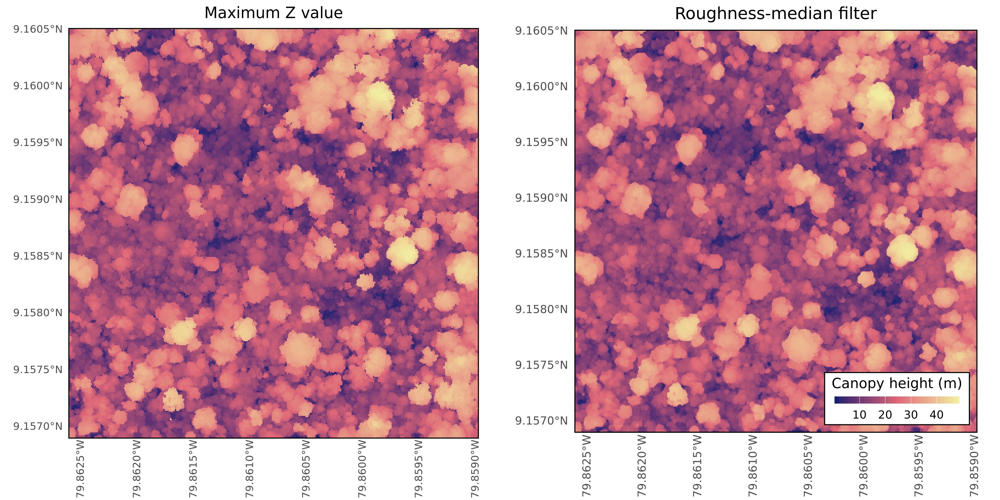


**A subset of the unfiltered canopy height model (the maxmimum Z value of each cell) and the cleaned canopy height model (the result of the roughness-median filter).**

In [21]:
# plot DTM and CHM for the field plot areas

range_DTM <- DTM_smooth |> terra::mask(plots_buf_200m) |> minmax()
range_CHM <- CHM_smooth |> terra::mask(plots_buf_200m) |> minmax()

suppressMessages({
    
p1_DTM <- ggR(DTM_smooth |> terra::crop(plots_buf_200m[1,]),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = cols_gradient,
                         na.value = cols_gradient[[1]],
                        #limits = c(range_DTM),
                        name = "Elevation (m)") +
   #geom_sf(data = plots[1,], color = "red3", fill = NA, linewidth = 1) +
         geom_sf_label(data = plots_buf_200m[1,],
                    aes(label = NAME),
                    vjust = 1,
                    nudge_y = 185,
                    size = 6, 
            label.r = unit(0, "pt")) +
    scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(0, 0))) +
    theme_bw(base_size = 8) +
   theme_map +
    coord_sf(crs = 32617) +
    guides(fill = guide_colourbar(title.position="top"))

p1_CHM <- ggR(CHM_smooth |> terra::crop(plots_buf_200m[1,]),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = cols_gradient,
                         na.value = cols_gradient[[1]],
                         limits = c(range_CHM),
                        name = "Canopy height (m)") +
   #geom_sf(data = plots[1,], color = "red3", fill = NA, linewidth = 1) +
   scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(0, 0))) +
    theme_bw(base_size = 8) +
   theme_map +
    coord_sf(crs = 32617) +
    guides(fill = guide_colourbar(title.position="top"))

p2_DTM <- ggR(DTM_smooth |> terra::crop(plots_buf_200m[2,]),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = cols_gradient,
                        na.value = cols_gradient[[1]],
                         #limits = c(range_DTM),
                        name = "Elevation (m)") +
   geom_sf(data = plots[2,], color = "white", fill = NA, linewidth = 1) +
      geom_sf_label(data = plots_buf_200m[2,],
                    aes(label = NAME),
                    vjust = 1,
                    nudge_y = 185,
                    size = 6, 
            label.r = unit(0, "pt")) +
    scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(0, 0))) +
    theme_bw(base_size = 8) +
   theme_map +
    guides(fill = guide_colourbar(title.position="top"))

p2_CHM <- ggR(CHM_smooth |> terra::crop(plots_buf_200m[2,]),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = cols_gradient,
                        na.value = cols_gradient[[1]],
                         limits = c(range_CHM),
                        name = "Canopy height (m)") +
   geom_sf(data = plots[2,], color = "white", fill = NA, linewidth = 1) +
   scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(0, 0))) +
    theme_bw(base_size = 8) +
   theme_map +
   guides(fill = "none")

p3_DTM <- ggR(DTM_smooth |> terra::crop(plots_buf_200m[3,]),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = cols_gradient,
                        na.value = cols_gradient[[1]],
                         #limits = c(range_DTM),
                        name = "Elevation (m)") +
   geom_sf(data = plots[3,], color = "white", fill = NA, linewidth = 1) +
         geom_sf_label(data = plots_buf_200m[3,],
                    aes(label = NAME),
                    vjust = 1,
                    nudge_y = 185,
                    size = 6, 
            label.r = unit(0, "pt")) +
    scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(0, 0))) +
    theme_bw(base_size = 8) +
   theme_map +
    guides(fill = guide_colourbar(title.position="top"))

p3_CHM <- ggR(CHM_smooth |> terra::crop(plots_buf_200m[3,]),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = cols_gradient,
                        na.value = cols_gradient[[1]],
                         limits = c(range_CHM),
                        name = "Canopy height (m)") +
   geom_sf(data = plots[3,], color = "white", fill = NA, linewidth = 1) +
   scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(0, 0))) +
    theme_bw(base_size = 8) +
   theme_map +
   guides(fill = "none")

p4_DTM <- ggR(DTM_smooth |> terra::crop(plots_buf_200m[4,]),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = cols_gradient,
                        na.value = cols_gradient[[1]],
                        # limits = c(range_DTM),
                        name = "Elevation (m)") +
   geom_sf(data = plots[4,], color = "white", fill = NA, linewidth = 1) +
         geom_sf_label(data = plots_buf_200m[4,],
                    aes(label = NAME),
                    vjust = 1,
                    nudge_y = 185,
                    size = 6, 
            label.r = unit(0, "pt")) +
    scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(0, 0))) +
    theme_bw(base_size = 8) +
   theme_map +
    guides(fill = guide_colourbar(title.position="top"))

p4_CHM <- ggR(CHM_smooth |> terra::crop(plots_buf_200m[4,]),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = cols_gradient,
                        na.value = cols_gradient[[1]],
                         limits = c(range_CHM),
                        name = "Canopy height (m)") +
   geom_sf(data = plots[4,], color = "white", fill = NA, linewidth = 1) +
   scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(0, 0))) +
    theme_bw(base_size = 8) +
   theme_map +
    guides(fill = "none")

fig <- ggarrange(p1_DTM, p2_DTM, p3_DTM, p4_DTM,
         p1_CHM, p2_CHM, p3_CHM, p4_CHM,
        ncol = 4, nrow = 2)

})
    
ggsave(plot = fig, 
       filename = "./figures/raster/plots_DTM_CHM.jpeg", 
       device = jpeg,
       width = 15,
       height = 8,
       units = "in",
       dpi = 300,
       bg = "white")

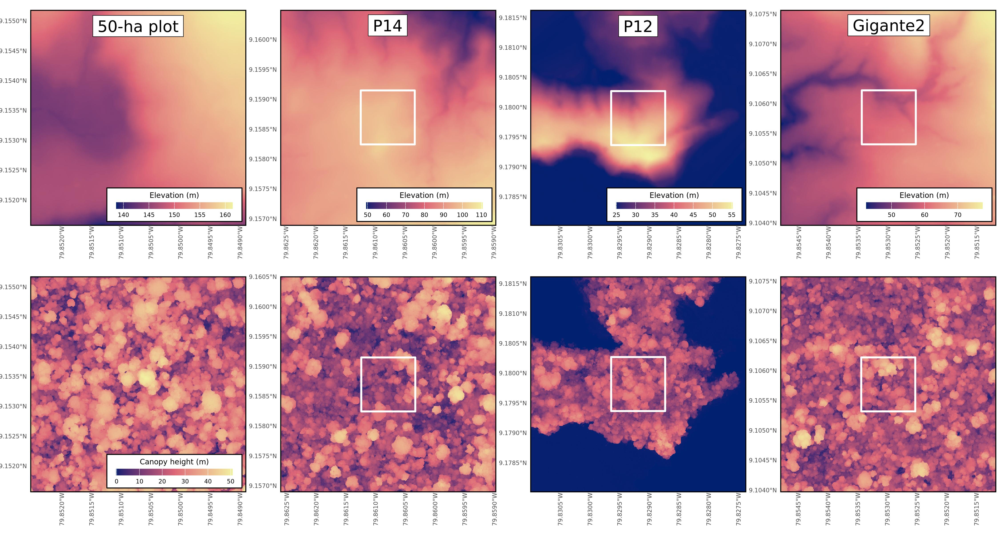


**400-by-400m subets of digital terrain models (DTM) and canopy height models (CHM) for the locations of the field plots. The 1-ha plot boundaries are shown in white.**

In [22]:
# plot the 50-ha plot

suppressMessages({

bci_50ha_CHM <- ggR(CHM_smooth |> terra::crop(bci_50ha_plot |>
               st_buffer(120)),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = cols_gradient,
                         na.value = cols_gradient[[1]],
                        # limits = c(range_CHM),
                        name = "Canopy height (m)") +
   geom_sf(data = bci_50ha_plot, color = "white", fill = NA, linewidth = 1) +
         geom_sf_label(data = plots_buf_200m[1,],
                    aes(label = NAME),
                    vjust = 1,
                    nudge_y = 325,
                    size = 6, 
            label.r = unit(0, "pt")) +
   scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(0, 0))) +
    theme_bw(base_size = 13) +
   theme_map +
    coord_sf(crs = 32617) +
    guides(fill = guide_colourbar(title.position="top"))

})

ggsave(plot = bci_50ha_CHM, 
       filename = "./figures/raster//BCI_50ha_CHM.jpeg", 
       device = jpeg,
       width = 14,
       height = 8,
       units = "in",
       dpi = 300,
       bg = "white")

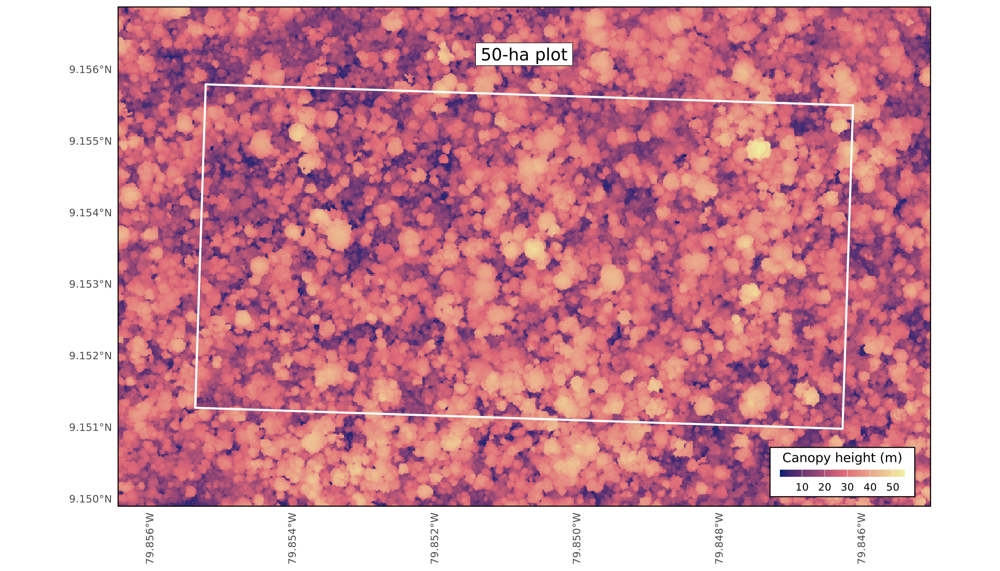


**A subset of the canopy height model (CHM) and the 50-ha field plot of Barro Colorado Island, outline shown in white.**

In [33]:
# plot the whole study area 

suppressMessages({

coverage_CHM <- ggR(CHM_smooth |>
                     clamp(lower = 0),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = cols_gradient,
                         na.value = cols_gradient[[1]],
                        # limits = c(range_CHM),
                        name = "Canopy height (m)") +
   geom_sf(data = plots, color = "white", fill = NA, linewidth = .7) +
     geom_sf_label(data = plots |> filter(NAME != "50-ha plot"), 
                   aes(label = NAME),
                   nudge_y = -300,
                    size = 6, 
            label.r = unit(0, "pt")) +
      geom_sf_label(data = plots |> filter(NAME == "50-ha plot"), 
                   aes(label = NAME),
                   nudge_y = -500,
                    size = 6, 
            label.r = unit(0, "pt")) +
   scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(-.16, 0))) +
     theme_bw(base_size = 13) +
   theme_map +
    #coord_sf(crs = 32617) +
    guides(fill = guide_colourbar(title.position="top"))

})
    
ggsave(plot = coverage_CHM, 
       filename = "./figures/raster/BCI_Gigante_CHM.jpeg", 
       device = jpeg,
       width = 14,
       height = 18,
       units = "in",
       dpi = 900,
       bg = "white")


**The full canopy height model (CHM) for the airborne laser scanning (ALS) acquisition, with field plot boundaries outlined in white. The study area covers all of Barro Colorado Island in the center, a portion of the Buena Vista Peninsula to the north, and a portion of the Gigante Peninsula to the south.**


### **6.** Generate figures comparing results from different users.



In [37]:
# plot two users' DTMs and CHMs for the first site

DTM_Andres <- rast('/projects/shared-buckets/andres.gonzalez_moreno/BCI_processed_local/dtm.tif')
CHM_Andres <- rast('/projects/shared-buckets/andres.gonzalez_moreno/BCI_processed_local/chm_highest.tif')

suppressMessages({

p1 <- ggR(DTM_Andres |> terra::crop(plots_buf_200m[2,]),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = cols_gradient,
                         na.value = cols_gradient[[1]]) +
   #geom_sf(data = plots[1,], color = "red3", fill = NA, linewidth = 1) +
   scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(0, 0))) +
    theme_bw(base_size = 13) +
   theme_map +
    coord_sf(crs = 32617) +
    guides(fill = "none") +
  ggtitle("DTM - Andres") +
  theme(plot.title = element_text(hjust = 0.5))

p2 <- ggR(DTM_smooth |> terra::crop(plots_buf_200m[2,]),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = cols_gradient,
                         na.value = cols_gradient[[1]],
                         breaks = c(60, 80, 100),
                        name = "Elevation (m)") +
    #geom_sf(data = plots_buf_200m[2,], color = "red3", fill = NA, linewidth = 1) +
   scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(0, 0))) +
    theme_bw(base_size = 13) +
   theme_map +
    coord_sf(crs = 32617) +
    guides(fill = guide_colourbar(title.position="top")) +
  ggtitle("DTM - Samuel") +
  theme(plot.title = element_text(hjust = 0.5))

p3 <- ggR(CHM_Andres |> terra::crop(plots_buf_200m[2,]),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = cols_gradient,
                         na.value = cols_gradient[[1]],
                        name = "CHM (m) - Andres") +
   #geom_sf(data = plots[1,], color = "red3", fill = NA, linewidth = 1) +
   scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(0, 0))) +
    theme_bw(base_size = 13) +
   theme_map +
    coord_sf(crs = 32617) +
    guides(fill = "none") +
  ggtitle("CHM - Andres") +
  theme(plot.title = element_text(hjust = 0.5))

p4 <- ggR(CHM_smooth |> terra::crop(plots_buf_200m[2,]),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = cols_gradient,
                         na.value = cols_gradient[[1]],
                        name = "Canopy height (m)") +
    #geom_sf(data = plots_buf_200m[2,], color = "red3", fill = NA, linewidth = 1) +
   scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(0, 0))) +
    theme_bw(base_size = 13) +
   theme_map +
    coord_sf(crs = 32617) +
    guides(fill = guide_colourbar(title.position="top")) +
  ggtitle("CHM - Samuel") +
  theme(plot.title = element_text(hjust = 0.5))

fig <- ggarrange(p1, p2, p3, p4,
        ncol = 2, nrow = 2)

})
    
ggsave(plot = fig, 
       filename = "./figures/raster/CHM_DTM_Samuel_Andres_P14.jpeg", 
       device = jpeg,
       width = 14,
       height = 14,
       units = "in",
       dpi = 300,
       bg = "white")

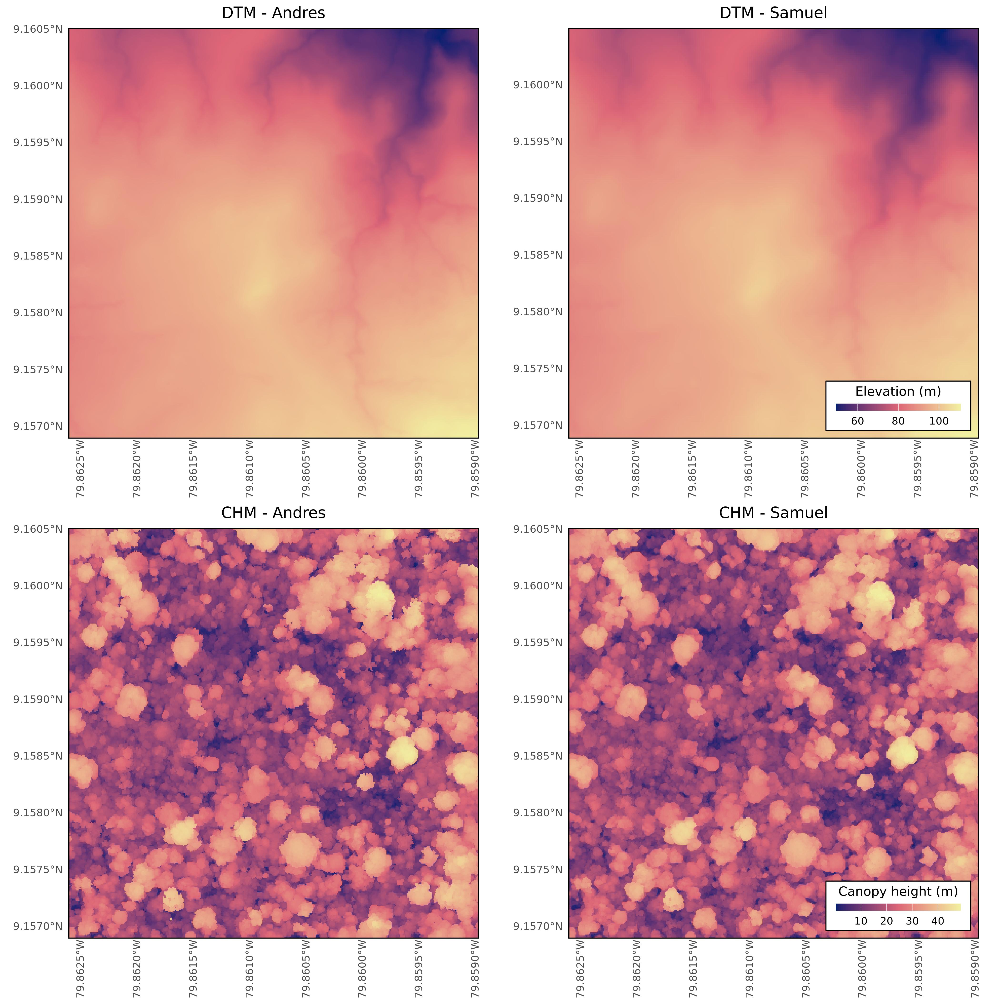



**Comparison of digital terrain models (DTM) and canopy height models (CHM) generated by two different users for the location of the P12 field plot.**

In [34]:
# plot two users' DTMs and CHMs for the second site

DTM_Andres <- rast('/projects/shared-buckets/andres.gonzalez_moreno/BCI_processed_local/dtm.tif')
CHM_Andres <- rast('/projects/shared-buckets/andres.gonzalez_moreno/BCI_processed_local/chm_highest.tif')

suppressMessages({

p1 <- ggR(DTM_Andres |> terra::crop(plots_buf_200m[1,]),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = cols_gradient,
                         na.value = cols_gradient[[1]]) +
   #geom_sf(data = plots[1,], color = "red3", fill = NA, linewidth = 1) +
   scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(0, 0))) +
    theme_bw(base_size = 13) +
   theme_map +
    coord_sf(crs = 32617) +
    guides(fill = "none") +
  ggtitle("DTM - Andres") +
  theme(plot.title = element_text(hjust = 0.5))

p2 <- ggR(DTM_smooth |> terra::crop(plots_buf_200m[1,]),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = cols_gradient,
                         na.value = cols_gradient[[1]],
                         breaks = seq(0, 200, 10),
                        name = "Elevation (m)") +
    #geom_sf(data = plots_buf_200m[2,], color = "red3", fill = NA, linewidth = 1) +
   scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(0, 0))) +
    theme_bw(base_size = 13) +
   theme_map +
    coord_sf(crs = 32617) +
    guides(fill = guide_colourbar(title.position="top")) +
  ggtitle("DTM - Samuel") +
  theme(plot.title = element_text(hjust = 0.5))

p3 <- ggR(CHM_Andres |> terra::crop(plots_buf_200m[1,]),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = cols_gradient,
                         na.value = cols_gradient[[1]],
                        name = "CHM (m) - Andres") +
   #geom_sf(data = plots[1,], color = "red3", fill = NA, linewidth = 1) +
   scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(0, 0))) +
    theme_bw(base_size = 13) +
   theme_map +
    coord_sf(crs = 32617) +
    guides(fill = "none") +
  ggtitle("CHM - Andres") +
  theme(plot.title = element_text(hjust = 0.5))

p4 <- ggR(CHM_smooth |> terra::crop(plots_buf_200m[1,]),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = cols_gradient,
                         na.value = cols_gradient[[1]],
                        name = "Canopy height (m)") +
    #geom_sf(data = plots_buf_200m[2,], color = "red3", fill = NA, linewidth = 1) +
   scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(0, 0))) +
    theme_bw(base_size = 13) +
   theme_map +
    coord_sf(crs = 32617) +
    guides(fill = guide_colourbar(title.position="top")) +
  ggtitle("CHM - Samuel") +
  theme(plot.title = element_text(hjust = 0.5))

fig <- ggarrange(p1, p2, p3, p4,
        ncol = 2, nrow = 2)

})
    
ggsave(plot = fig, 
       filename = "./figures/raster/CHM_DTM_Samuel_Andres_50haplot.jpeg", 
       device = jpeg,
       width = 14,
       height = 14,
       units = "in",
       dpi = 300,
       bg = "white")

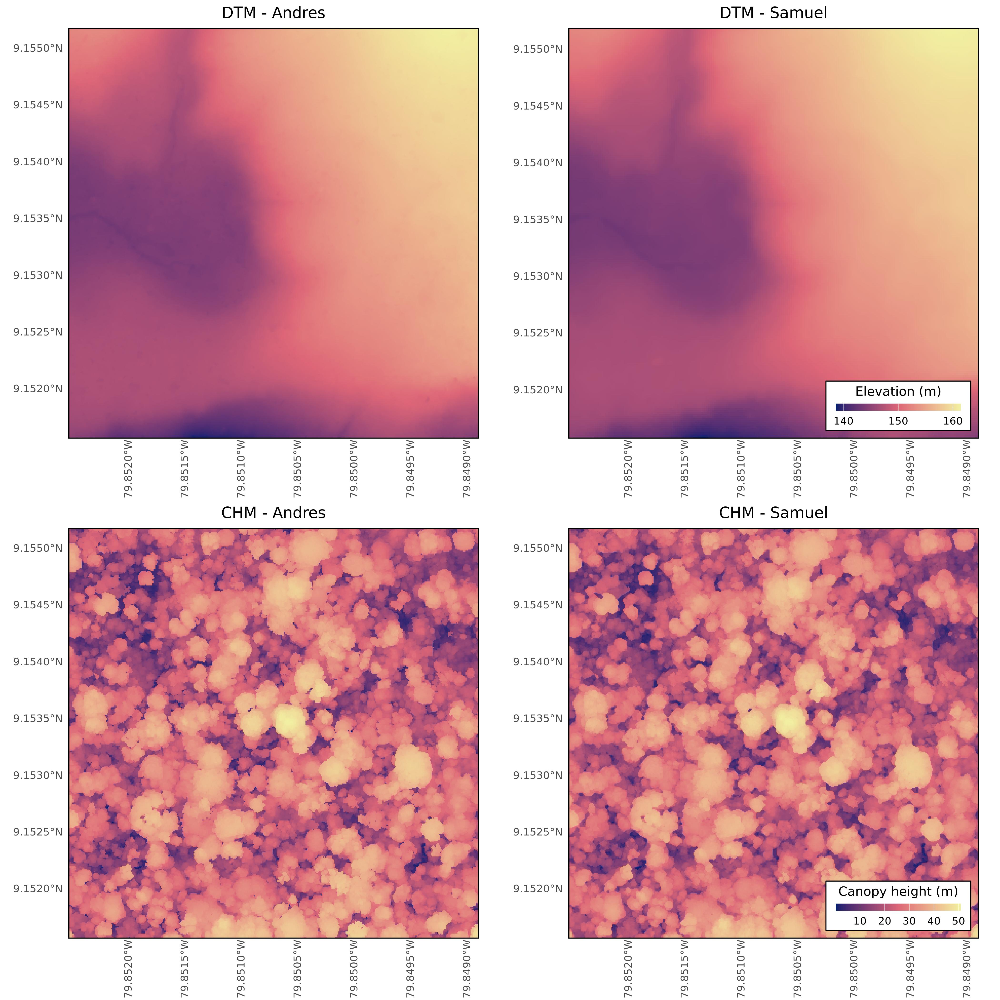



**Comparison of digital terrain models (DTM) and canopy height models (CHM) generated by two different users for the location of centroid of the 50-ha field plot.**

In [35]:

# filling irregularities in the CHM with roughness and median filters:
# first, we identify areas of likely gaps, noise, or sparse data where 
# the terrain roughness index (TRI) is greater than 4. We then apply a 
# median filter to those pixels only.


CHM_comparison <- (CHM_smooth |> terra::crop(plots_buf_200m[2,])) - 
                    (CHM_Andres |> terra::crop(plots_buf_200m[2,]))

suppressMessages({

p1 <- ggR(CHM_comparison |> terra::crop(plots_buf_200m[2,]),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = c("black", "grey50", "white"),
                         #na.value = cols_gradient[[1]],
                        name = "CHM difference (m)") +
   #geom_sf(data = plots[1,], color = "red3", fill = NA, linewidth = 1) +
   scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(0, 0))) +
    theme_bw(base_size = 13) +
    theme_map +
    coord_sf(crs = 32617) +
    guides(fill = guide_colourbar(title.position="top"))

CHM_comparison_hist <- CHM_comparison |> 
             terra::crop(plots_buf_200m[2,]) |>
             as.data.frame() |>
            rename("Difference (m)" = 1)

p2 <- ggplot(data = CHM_comparison_hist,
            aes(x = `Difference (m)`)) +
    scale_fill_gradientn(colors = cols_gradient_biomass,
                         #na.value = cols_gradient[[1]],
                        name = "Difference (m)") +
   geom_histogram(bins = 50) +
    geom_vline(xintercept = 0, color = "red") +
    scale_x_continuous(breaks = seq(-30, 30, 5)) +
    theme_bw(base_size = 13) +
    theme(panel.grid.major = element_blank(),
         panel.grid.minor = element_blank())

###

DTM_comparison <- (DTM_smooth |> resample(DTM_Andres) |> terra::crop(plots_buf_200m[2,])) - 
                    (DTM_Andres |> terra::crop(plots_buf_200m[2,]))

p3 <- ggR(DTM_comparison |> terra::crop(plots_buf_200m[2,]),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = c("black", "grey50", "white"),
                         #na.value = cols_gradient[[1]],
                        name = "DTM difference (m)") +
   #geom_sf(data = plots[1,], color = "red3", fill = NA, linewidth = 1) +
   scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(0, 0))) +
    theme_bw(base_size = 13) +
    theme_map +
    coord_sf(crs = 32617) +
    guides(fill = guide_colourbar(title.position="top"))

DTM_comparison_hist <- DTM_comparison |> 
             terra::crop(plots_buf_200m[2,]) |>
             as.data.frame() |>
            rename("Difference (m)" = 1)

p4 <- ggplot(data = DTM_comparison_hist,
            aes(x = `Difference (m)`)) +
    scale_fill_gradientn(colors = cols_gradient_biomass,
                         #na.value = cols_gradient[[1]],
                        name = "Difference (m)") +
   geom_histogram(bins = 50) +
    geom_vline(xintercept = 0, color = "red") +
    scale_x_continuous(breaks = seq(-30, 30, 1)) +
    theme_bw(base_size = 13) +
    theme(panel.grid.major = element_blank(),
         panel.grid.minor = element_blank())

###

fig <- ggarrange(p1, p2, p3, p4,
        ncol = 2, nrow = 2)

})
    
ggsave(plot = fig, 
       filename = "./figures/raster/comparison_Samuel_Andres_P14.jpeg", 
       device = jpeg,
       width = 14,
       height = 14,
       units = "in",
       dpi = 300,
       bg = "white")

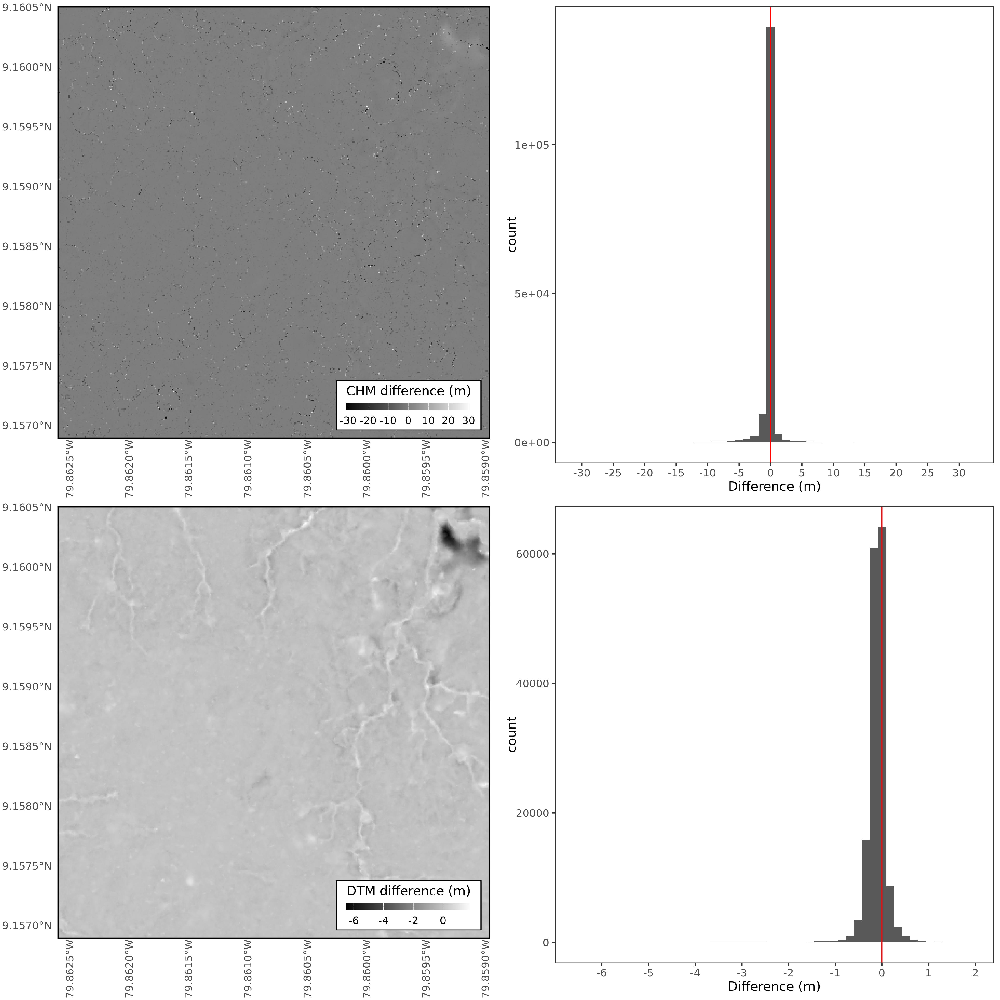



**Difference in meters between the two users' digital terrain models (DTM) and canopy height models (CHM) for the location of the P12 field plot.**

In [36]:

# filling irregularities in the CHM with roughness and median filters:
# first, we identify areas of likely gaps, noise, or sparse data where 
# the terrain roughness index (TRI) is greater than 4. We then apply a 
# median filter to those pixels only.

suppressMessages({

CHM_comparison <- (CHM_smooth |> terra::crop(plots_buf_200m[1,])) - 
                    (CHM_Andres |> terra::crop(plots_buf_200m[1,]))

p1 <- ggR(CHM_comparison |> terra::crop(plots_buf_200m[1,]),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = c("black", "grey50", "white"),
                         #na.value = cols_gradient[[1]],
                        name = "CHM difference (m)") +
   #geom_sf(data = plots[1,], color = "red3", fill = NA, linewidth = 1) +
   scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(0, 0))) +
    theme_bw(base_size = 13) +
    theme_map +
    coord_sf(crs = 32617) +
    guides(fill = guide_colourbar(title.position="top"))

CHM_comparison_hist <- CHM_comparison |> 
             terra::crop(plots_buf_200m[1,]) |>
             as.data.frame() |>
            rename("Difference (m)" = 1)

p2 <- ggplot(data = CHM_comparison_hist,
            aes(x = `Difference (m)`)) +
    scale_fill_gradientn(colors = cols_gradient_biomass,
                         #na.value = cols_gradient[[1]],
                        name = "Difference (m)") +
   geom_histogram(bins = 50) +
    geom_vline(xintercept = 0, color = "red") +
    scale_x_continuous(breaks = seq(-30, 30, 5)) +
    theme_bw(base_size = 13) +
    theme(panel.grid.major = element_blank(),
         panel.grid.minor = element_blank())

###

DTM_comparison <- (DTM_smooth |> resample(DTM_Andres) |> terra::crop(plots_buf_200m[1,])) - 
                    (DTM_Andres |> terra::crop(plots_buf_200m[1,]))

p3 <- ggR(DTM_comparison |> terra::crop(plots_buf_200m[1,]),
           geom_raster = TRUE) +
    scale_fill_gradientn(colors = c("black", "grey50", "white"),
                         #na.value = cols_gradient[[1]],
                        name = "DTM difference (m)") +
   #geom_sf(data = plots[1,], color = "red3", fill = NA, linewidth = 1) +
   scale_x_continuous(expand = expansion(mult = c(0, 0))) + 
   scale_y_continuous(expand = expansion(mult = c(0, 0))) +
    theme_bw(base_size = 13) +
    theme_map +
    coord_sf(crs = 32617) +
    guides(fill = guide_colourbar(title.position="top"))

DTM_comparison_hist <- DTM_comparison |> 
             terra::crop(plots_buf_200m[1,]) |>
             as.data.frame() |>
            rename("Difference (m)" = 1)

p4 <- ggplot(data = DTM_comparison_hist,
            aes(x = `Difference (m)`)) +
    scale_fill_gradientn(colors = cols_gradient_biomass,
                         #na.value = cols_gradient[[1]],
                        name = "Difference (m)") +
   geom_histogram(bins = 50) +
    geom_vline(xintercept = 0, color = "red") +
    scale_x_continuous(breaks = seq(-30, 30, .5)) +
    theme_bw(base_size = 13) +
    theme(panel.grid.major = element_blank(),
         panel.grid.minor = element_blank())

###

fig <- ggarrange(p1, p2, p3, p4,
        ncol = 2, nrow = 2)

})

ggsave(plot = fig, 
       filename = "./figures/raster/comparison_Samuel_Andres_50haplot.jpeg", 
       device = jpeg,
       width = 14,
       height = 14,
       units = "in",
       dpi = 300,
       bg = "white")

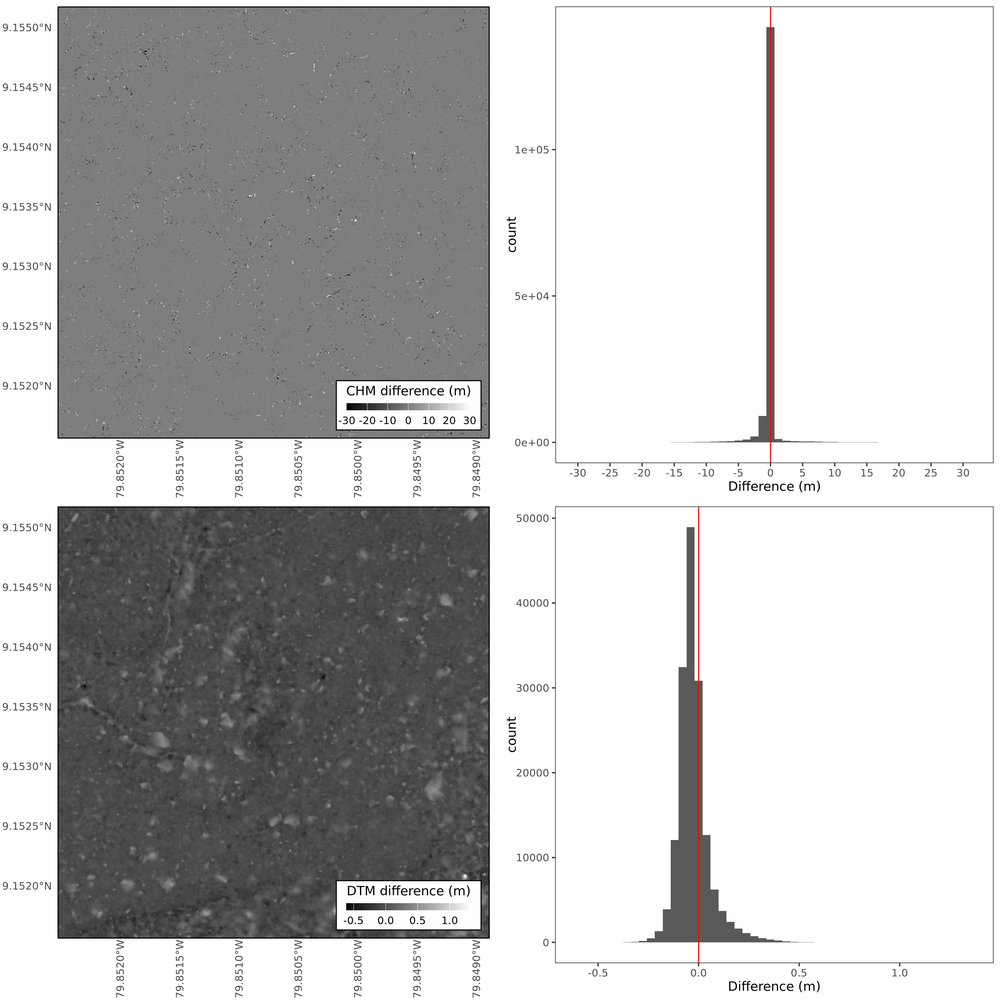



**Difference in meters between the two users' digital terrain models (DTM) and canopy height models (CHM) for the location of the 50-ha field plot.**


### **7.** Quantify aboveground biomass from field data.



### **8.** Build a model of aboveground biomass from ALS metrics.



### **9.** Validate the model.



### **10** Generate a biomass reference map for the entire ALS acquisition area

